# Setup

In [ ]:
# !pip install -q -U diffusers peft imageio-ffmpeg

pakiety do zainstalowania:
   - `diffusers` - To biblioteka do generowania obrazów za pomocą modeli dyfuzyjnych.
   - `peft` - Skrót od "Parameter-Efficient Fine-Tuning". To biblioteka do wydajnego dostrajania dużych modeli językowych.
   - `imageio-ffmpeg` - To rozszerzenie do biblioteki imageio, które umożliwia obsługę plików wideo za pomocą FFmpeg.

In [ ]:
import torch

from diffusers import MotionAdapter, AnimateDiffPipeline, DDIMScheduler
from diffusers.utils import export_to_gif, export_to_video
from IPython.display import Image, Video


1. `import torch`
   - Importuje bibliotekę PyTorch, która jest powszechnie używana do obliczeń numerycznych i uczenia maszynowego.

2. - Importuje konkretne klasy z biblioteki diffusers:
     - `MotionAdapter`: odpowiada za adaptację modelu do generowania ruchu.
     - `AnimateDiffPipeline`: Pipeline do generowania animacji przy użyciu modeli dyfuzyjnych.
     - `EulerDiscreteScheduler` i `DDIMScheduler`: To różne typy schedulerów używanych w procesie generowania.

3. - Importuje funkcje pomocnicze z modułu utils biblioteki diffusers:
     - `export_to_gif`: Funkcja do eksportowania wyników jako pliki GIF.
     - `export_to_video`: Funkcja do eksportowania wyników jako pliki wideo.

In [ ]:
class CFG:
    adapter = "guoyww/animatediff-motion-adapter-v1-5-2"
    base_model = "emilianJR/epiCRealism"
    seed = 49
    guidance = 7.5
    num_inference_steps = 25
    num_frames = 28
    device = "cuda"
    dtype = torch.float16

`CFG`:

1. `adapter = "guoyww/animatediff-motion-adapter-v1-5-2"`
   - Określa ścieżkę do adaptera ruchu, który będzie używany w procesie generowania animacji.

2. `base_model = "emilianJR/epiCRealism"`
   - Wskazuje na bazowy model, który będzie używany do generowania obrazów.

3. `seed = 49`
   - Ustawia ziarno (seed) dla generatora liczb losowych, co zapewnia powtarzalność wyników.

4. `guidance = 7.5`
   - Określa siłę guidance scale, parametr wpływający na to, jak mocno model podąża za podpowiedzią tekstową.

5. `num_inference_steps = 25`
   - Określa liczbę kroków inferencji w procesie generowania.

6. `num_frames = 28`
   - Ustala liczbę klatek, które mają być wygenerowane w animacji.

7. `device = "cuda"`
   - Wskazuje, że obliczenia mają być wykonywane na GPU

8. `dtype = torch.float16`
   - Określa typ danych dla obliczeń jako 16-bitowe liczby zmiennoprzecinkowe, co może przyspieszyć obliczenia kosztem niewielkiej utraty precyzji.

# Functions

# Pipe - podstawa

In [ ]:
# setup the pipeline

adapter = MotionAdapter.from_pretrained(CFG.adapter)


pipe = AnimateDiffPipeline.from_pretrained(CFG.base_model, motion_adapter=adapter)

scheduler = DDIMScheduler.from_pretrained(
    CFG.base_model, subfolder="scheduler",
    clip_sample=False, timestep_spacing="linspace",
    beta_schedule="linear", steps_offset=1,
)

pipe.scheduler = scheduler

pipe.to(CFG.device)

pipe.enable_vae_slicing()
pipe.enable_model_cpu_offload()

The config attributes {'motion_activation_fn': 'geglu', 'motion_attention_bias': False, 'motion_cross_attention_dim': None} were passed to MotionAdapter, but are not expected and will be ignored. Please verify your config.json configuration file.


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


Ten kod konfiguruje pipeline do generowania animacji. Omówmy go krok po kroku:

1. `adapter = MotionAdapter.from_pretrained(CFG.adapter)`
   - Ładuje predefiniowany adapter ruchu z określonej ścieżki (zdefiniowanej w klasie CFG).

2. `pipe = AnimateDiffPipeline.from_pretrained(CFG.base_model, motion_adapter=adapter)`
   - Tworzy główny pipeline AnimateDiff, ładując bazowy model i dodając do niego wcześniej załadowany adapter ruchu.

3. `scheduler = DDIMScheduler.from_pretrained(...)`
   - Konfiguruje scheduler DDIM (Denoising Diffusion Implicit Models) z określonymi parametrami:
     - `CFG.base_model, subfolder="scheduler"`: Ładuje scheduler z podfolderu modelu bazowego.
     - `clip_sample=False`: Wyłącza przycinanie próbek.
     - `timestep_spacing="linspace"`: Ustawia równomierne rozłożenie kroków czasowych.
     - `beta_schedule="linear"`: Ustawia liniowy harmonogram beta.
     - `steps_offset=1`: Dodaje przesunięcie o 1 krok.

4. `pipe.scheduler = scheduler`
   - Przypisuje skonfigurowany scheduler do pipeline'u.

5. `pipe.to(CFG.device)`
   - Przenosi cały model na określone urządzenie (prawdopodobnie GPU, jak zdefiniowano w CFG).

6. `pipe.enable_vae_slicing()`
   - Włącza "cięcie" VAE (Variational Autoencoder), co może pomóc w optymalizacji pamięci.

7. `pipe.enable_model_cpu_offload()`
   - Włącza funkcję offloadingu modelu na CPU, co pozwala na efektywniejsze zarządzanie pamięcią GPU.


Argumenty do schedulera:
1. `CFG.base_model`:
   - Jest to ścieżka do bazowego modelu, z którego scheduler ma być załadowany.
   - Scheduler jest zwykle częścią większego modelu dyfuzyjnego, więc ładujemy go z tego samego źródła co model główny.

2. `subfolder="scheduler"`:
   - Określa, że scheduler powinien być załadowany z podfolderu o nazwie "scheduler" w strukturze modelu bazowego.
   - Jest to konwencja organizacyjna stosowana w wielu modelach dyfuzyjnych.

3. `clip_sample=False`:
   - Gdy ustawione na `False`, wyłącza przycinanie wartości próbek do zakresu [-1, 1].
   - Pozwala to na zachowanie pełnego zakresu wartości generowanych przez model, co może być korzystne w niektórych przypadkach.

4. `timestep_spacing="linspace"`:
   - Określa sposób rozmieszczenia kroków czasowych w procesie dyfuzji.
   - "linspace" oznacza, że kroki czasowe będą rozmieszczone równomiernie w przestrzeni liniowej.
   - Alternatywą mogłoby być np. "quadratic" dla rozmieszczenia kwadratowego.

5. `beta_schedule="linear"`:
   - Definiuje harmonogram wartości beta używanych w procesie dyfuzji.
   - "linear" oznacza, że wartości beta będą zwiększać się liniowo w czasie.
   - Jest to często stosowane ustawienie, które zapewnia stabilny proces dyfuzji.

6. `steps_offset=1`:
   - Dodaje przesunięcie o 1 do liczby kroków.
   - Może to być użyteczne w niektórych implementacjach do zapewnienia prawidłowej inicjalizacji lub zakończenia procesu dyfuzji.

Te parametry razem konfigurują scheduler DDIM (Denoising Diffusion Implicit Models) do pracy w określony sposób. DDIM to zaawansowana technika próbkowania dla modeli dyfuzyjnych, która pozwala na szybsze i bardziej kontrolowane generowanie próbek niż tradycyjne metody.

In [ ]:
output = pipe(
    prompt="A space rocket with trails of smoke behind it launching into space from the desert, 4k, high resolution",
    negative_prompt="bad quality, worse quality, low resolution",
    num_frames = CFG.num_frames,
    guidance_scale = CFG.guidance,
    num_inference_steps = CFG.num_inference_steps,
    generator=torch.Generator("cpu").manual_seed(CFG.seed),
)
frames = output.frames[0]
export_to_gif(frames, "muh_gif0.gif")
export_to_video(output.frames[0], "muh_film0.mp4", fps=7)

  0%|          | 0/25 [00:00<?, ?it/s]

'muh_film0.mp4'

Ten kod generuje animację i eksportuje ją do formatu GIF i MP4. Przeanalizujmy go krok po kroku:

1. Wywołanie pipeline'u (`pipe`):
   - `prompt`: Opis sceny, którą chcemy wygenerować. W tym przypadku to "rakieta kosmiczna startująca z pustyni, z smugami dymu za nią, w 4K, wysokiej rozdzielczości".
   - `negative_prompt`: Opis cech, których chcemy uniknąć w generowanym obrazie, tutaj "zła jakość, gorsza jakość, niska rozdzielczość".
   - `num_frames`: Liczba klatek do wygenerowania, pobrana z konfiguracji (CFG.num_frames).
   - `guidance_scale`: Siła wpływu promptu na generowanie, pobrana z CFG.guidance.
   - `num_inference_steps`: Liczba kroków inferencji, pobrana z CFG.num_inference_steps.
   - `generator`: Generator liczb losowych inicjowany ziarnem (seed) z konfiguracji, co zapewnia powtarzalność wyników.

2. Zapisanie wygenerowanych klatek:
   - `frames = output.frames[0]`: Wyodrębnia pierwszą sekwencję klatek z wyniku.

3. Eksport do GIF:
   - `export_to_gif(frames, "muh_gif0.gif")`: Zapisuje sekwencję klatek jako animowany GIF o nazwie "muh_gif0.gif".

4. Eksport do wideo:
   - `export_to_video(output.frames[0], "muh_film0.mp4", fps=7)`: Zapisuje sekwencję klatek jako plik wideo MP4 o nazwie "muh_film0.mp4" z prędkością 7 klatek na sekundę.

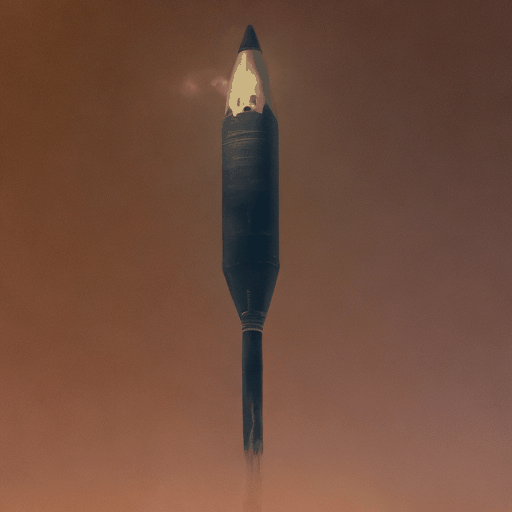

In [ ]:
# show
Image("muh_gif0.gif")

In [ ]:
prompt1 = "a majestic galeon ship sailing in the open seas, some waves, storm clouds visible in the sky"
output=pipe(
    prompt= prompt1,
    negative_prompt ="bad quality, worse quality, low resolution",
    num_frames = CFG.num_frames,
    guidance_scale = CFG.guidance,
    num_inference_steps = CFG.num_inference_steps,
    generator=torch.Generator('cpu').manual_seed(CFG.seed),
)

export_to_gif(output.frames[0], 'muh_gif1.gif' )
export_to_video(output.frames[0], "muh_film1.mp4", fps=7)

  0%|          | 0/25 [00:00<?, ?it/s]

'muh_film1.mp4'

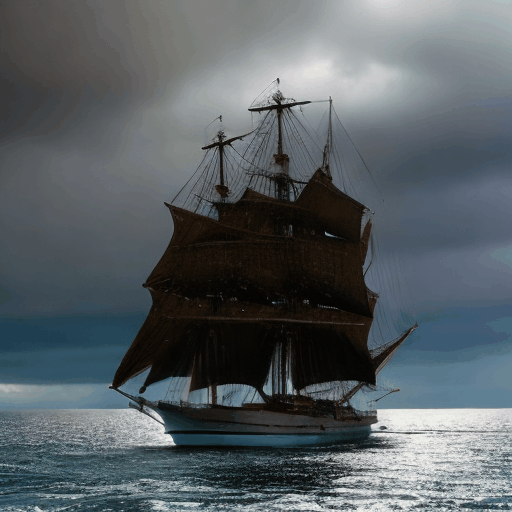

In [ ]:
# show
display(Video("muh_film1.mp4"))

In [ ]:
prompt2 = "Promotional product advertisement film of a glass ball perfume sitting on top of a tree branch, with white flowers, 4k, high resolution"

output=pipe(
    prompt= prompt2,
    negative_prompt ="bad quality, worse quality, low resolution",
    num_frames = CFG.num_frames,
    guidance_scale = CFG.guidance,
    num_inference_steps = CFG.num_inference_steps,
    generator=torch.Generator('cpu').manual_seed(CFG.seed),
)

export_to_gif(output.frames[0], 'muh_gif2.gif' )
export_to_video(output.frames[0], "muh_film2.mp4", fps=7)

  0%|          | 0/25 [00:00<?, ?it/s]

'muh_film2.mp4'

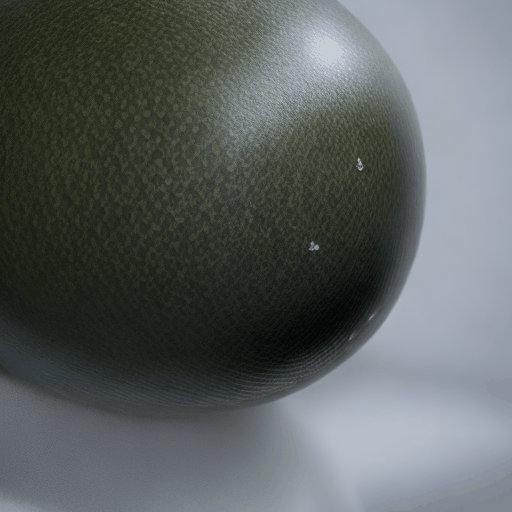

In [ ]:
# show
display(Video("muh_film2.mp4"))

# Pipe + extras

In [ ]:
del pipe

In [ ]:
class CFG:
    adapter = "guoyww/animatediff-motion-adapter-v1-5-2"
    base_model = "emilianJR/epiCRealism"
    motion =  "guoyww/animatediff-motion-lora-zoom-out"
    seed = 41
    guidance = 7.5
    num_inference_steps = 25
    num_frames = 28
    device = "cuda"
    dtype = torch.float16

`CFG`:

`adapter` - ścieżka do adaptera modelu AnimateDiff, który odpowiada za dodanie możliwości animacji do modelu bazowego

`base_model` - ścieżka do podstawowego modelu generowania obrazów epiCRealism

`motion` - ścieżka do modułu LoRA odpowiadającego za efekt oddalania kamery

`seed` - ziarno losowości ustawione na 41, zapewniające powtarzalne wyniki

`guidance` - współczynnik guidance scale o wartości 7.5, kontrolujący jak bardzo model trzyma się podanego opisu

`num_inference_steps` - liczba kroków generowania pojedynczej klatki, ustawiona na 25

`num_frames` - liczba klatek w wygenerowanej animacji, ustawiona na 28

`device` - określa użycie karty graficznej (CUDA) do obliczeń

`dtype` - precyzja obliczeń ustawiona na float16, co oszczędza pamięć GPU kosztem niewielkiej utraty dokładności

In [ ]:
adapter = MotionAdapter.from_pretrained(CFG.adapter)


pipe = AnimateDiffPipeline.from_pretrained(CFG.base_model, motion_adapter=adapter)

pipe.load_lora_weights(CFG.motion, adapter_name="zoom-out")

scheduler = DDIMScheduler.from_pretrained(
    CFG.base_model, subfolder="scheduler",
    clip_sample=False, timestep_spacing="linspace",
    beta_schedule="linear", steps_offset=1,
)

pipe.scheduler = scheduler

pipe.to(CFG.device)

pipe.enable_vae_slicing()
pipe.enable_model_cpu_offload()

The config attributes {'motion_activation_fn': 'geglu', 'motion_attention_bias': False, 'motion_cross_attention_dim': None} were passed to MotionAdapter, but are not expected and will be ignored. Please verify your config.json configuration file.


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

Te linie kodu inicjalizują i konfigurują pipeline do generowania animacji:

`adapter = MotionAdapter.from_pretrained(CFG.adapter)` - ładuje adapter ruchu z wcześniej zdefiniowanej ścieżki

`pipe = AnimateDiffPipeline.from_pretrained(CFG.base_model, motion_adapter=adapter)` - tworzy główny pipeline łącząc model bazowy z adapterem ruchu

`pipe.load_lora_weights(CFG.motion, adapter_name="zoom-out")` - dodaje moduł LoRA odpowiedzialny za efekt oddalania

Następnie konfigurowany jest scheduler DDIM, który kontroluje proces generowania:
- `clip_sample=False` - wyłącza przycinanie próbek
- `timestep_spacing="linspace"` - ustawia równomierne odstępy czasowe
- `beta_schedule="linear"` - definiuje liniowy harmonogram beta
- `steps_offset=1` - dodaje przesunięcie kroków o 1

`pipe.to(CFG.device)` - przenosi model na GPU

Ostatnie dwie linie optymalizują zużycie pamięci:
- `enable_vae_slicing()` - włącza przetwarzanie VAE w mniejszych częściach
- `enable_model_cpu_offload()` - pozwala na przechowywanie nieużywanych części modelu w pamięci RAM

In [ ]:
output = pipe(
    prompt="A space rocket with trails of smoke behind it launching into space from the desert, 4k, high resolution",
    negative_prompt="bad quality, worse quality, low resolution",
    num_frames = CFG.num_frames,
    guidance_scale = CFG.guidance,
    num_inference_steps = CFG.num_inference_steps,
    generator=torch.Generator("cpu").manual_seed(CFG.seed),
)
frames = output.frames[0]
export_to_gif(frames, "muh_gif0_e.gif")
export_to_video(output.frames[0], "muh_film0_e.mp4", fps=7)

  0%|          | 0/25 [00:00<?, ?it/s]

'muh_film0_e.mp4'

Te linie kodu generują i zapisują animację:

`pipe(...)` wywołuje pipeline z następującymi parametrami:
- `prompt` - opis sceny: rakieta kosmiczna startująca z pustyni z smugami dymu, w wysokiej rozdzielczości 4K
- `negative_prompt` - cechy niepożądane: niska jakość i rozdzielczość
- `num_frames` - liczba klatek zdefiniowana w CFG
- `guidance_scale` - siła wpływu prompta na generowanie
- `num_inference_steps` - liczba kroków generowania każdej klatki
- `generator` - generator losowości z ustawionym ziarnem dla powtarzalności wyników

`frames = output.frames[0]` - wyodrębnia wygenerowane klatki z outputu

Ostatnie dwie linie zapisują animację w dwóch formatach:
- `export_to_gif()` - zapisuje jako plik GIF "muh_gif0_e.gif"
- `export_to_video()` - zapisuje jako plik MP4 "muh_film0_e.mp4" z prędkością 7 klatek na sekundę

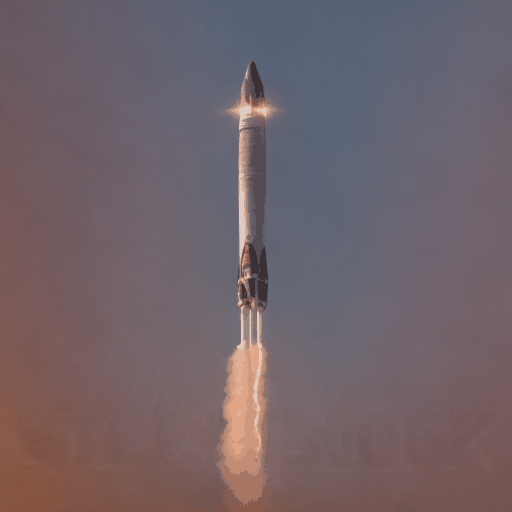

In [ ]:
# show
display(Video("muh_film0_e.mp4"))

In [ ]:
prompt1 = "a majestic galeon ship sailing in the open seas, some waves, storm clouds visible in the sky"
output=pipe(
    prompt= prompt1,
    negative_prompt ="bad quality, worse quality, low resolution",
    num_frames = CFG.num_frames,
    guidance_scale = CFG.guidance,
    num_inference_steps = CFG.num_inference_steps,
    generator=torch.Generator('cpu').manual_seed(CFG.seed),
)

export_to_gif(output.frames[0], 'muh_gif1_e.gif' )
export_to_video(output.frames[0], "muh_film1_e.mp4", fps=7)

  0%|          | 0/25 [00:00<?, ?it/s]

'muh_film1_e.mp4'

In [ ]:
prompt2 = "Promotional product advertisement film of a glass ball perfume sitting on top of a tree branch, with white flowers, 4k, high resolution"

output=pipe(
    prompt= prompt2,
    negative_prompt ="bad quality, worse quality, low resolution",
    num_frames = CFG.num_frames,
    guidance_scale = CFG.guidance,
    num_inference_steps = CFG.num_inference_steps,
    generator=torch.Generator('cpu').manual_seed(CFG.seed),
)

export_to_gif(output.frames[0], 'muh_gif2_e.gif' )
export_to_video(output.frames[0], "muh_film2_e.mp4", fps=7)

  0%|          | 0/25 [00:00<?, ?it/s]

'muh_film2_e.mp4'

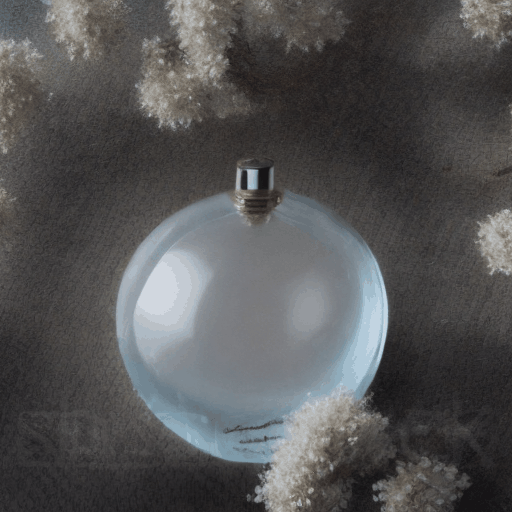

In [ ]:
# show
display(Video("muh_film2_e.mp4"))